In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta
import warnings

warnings.filterwarnings("ignore")

from sklearn.model_selection import train_test_split, TimeSeriesSplit
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima.model import ARIMA
import xgboost as xgb

In [2]:
data = pd.read_csv("C:/Users/Usuario/Downloads/datos.csv")

In [3]:
data.info()
data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119143 entries, 0 to 119142
Data columns (total 44 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       119143 non-null  object 
 1   customer_id                    119143 non-null  object 
 2   order_status                   119143 non-null  object 
 3   order_purchase_timestamp       119143 non-null  object 
 4   order_approved_at              118966 non-null  object 
 5   order_delivered_carrier_date   117057 non-null  object 
 6   order_delivered_customer_date  115722 non-null  object 
 7   order_estimated_delivery_date  119143 non-null  object 
 8   customer_unique_id             119143 non-null  object 
 9   customer_zip_code_prefix       119143 non-null  int64  
 10  customer_city                  119143 non-null  object 
 11  customer_state                 119143 non-null  object 
 12  payment_sequential            

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,...,product_height_cm,product_width_cm,zip_code_prefix,seller_city,seller_state,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,product_category_name_english
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,8.0,13.0,9350.0,maua,SP,-23.680114,-46.452454,maua,SP,housewares
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,8.0,13.0,9350.0,maua,SP,-23.680114,-46.452454,maua,SP,housewares
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,...,8.0,13.0,9350.0,maua,SP,-23.680114,-46.452454,maua,SP,housewares
3,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,47813,...,13.0,19.0,31570.0,belo horizonte,SP,-19.810119,-43.984727,belo horizonte,MG,perfumery
4,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,3a653a41f6f9fc3d2a113cf8398680e8,75265,...,19.0,21.0,14840.0,guariba,SP,-21.362358,-48.232976,guariba,SP,auto


In [4]:
plt.rcParams['figure.figsize'] = (12, 6)
missing_values = data.isnull().sum().sort_values(ascending=False)
missing_percentage = (missing_values / len(data)) * 100
missing_data = pd.DataFrame({'Missing Values': missing_values, 'Percentage (%)': missing_percentage})
missing_data = missing_data[missing_data['Missing Values'] > 0]

In [5]:
numerical_df = data.select_dtypes(include=['float64', 'int64'])
correlation_matrix = numerical_df.corr()

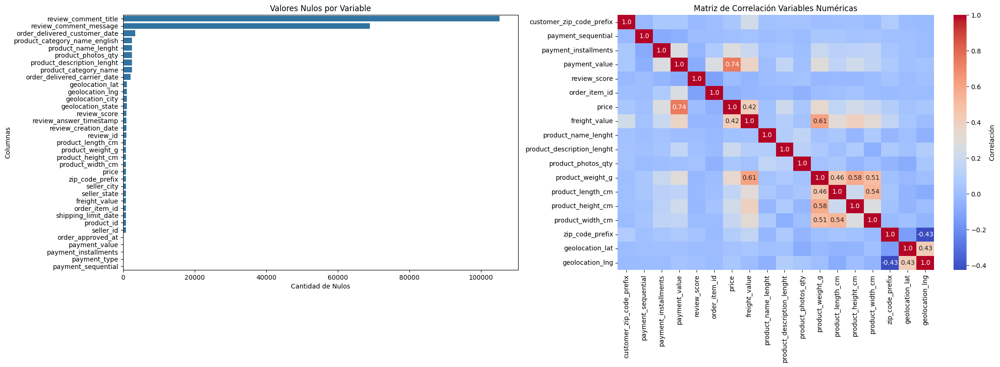

In [6]:
fig, axes = plt.subplots(1, 2, figsize=(22, 8))
sns.barplot(y=missing_data.index, x=missing_data['Missing Values'], ax=axes[0])
axes[0].set_title("Valores Nulos por Variable")
axes[0].set_xlabel("Cantidad de Nulos")
axes[0].set_ylabel("Columnas")

text_matrix = correlation_matrix.copy()
mask = (abs(correlation_matrix) < 0.4)

text_matrix = correlation_matrix.round(2).astype(str)
text_matrix[mask] = ''
sns.heatmap(correlation_matrix, 
            annot=text_matrix, 
            fmt='', 
            cmap='coolwarm', 
            ax=axes[1],
            cbar_kws={'label': 'Correlación'})
axes[1].set_title("Matriz de Correlación Variables Numéricas")
plt.tight_layout()
plt.show()

En el gráfico de la izquierda se observa la cantidad de valores nulos por variable. Las variables con mayor cantidad de nulos son review_comment_title y review_comment_message, superando los 100,000 valores faltantes. Esto sugiere que muchos usuarios no dejan comentarios escritos en sus reseñas, lo cual puede ser un patrón natural en este tipo de datos. Otras variables con nulos importantes son order_delivered_customer_date, product_category_name_english y algunas relacionadas con coordenadas geográficas como geolocation_lat y geolocation_lng, aunque en menor proporción. Este análisis es clave para definir estrategias de limpieza o imputación de datos antes del modelado.

En el gráfico de la derecha, la matriz de correlación entre variables numéricas revela algunas relaciones destacadas. Las variables más fuertemente correlacionadas son payment_value, payment_installments y payment_sequential, con correlaciones de 1, lo cual sugiere que podrían contener información redundante o derivada entre sí. También se evidencia una correlación moderada entre price y freight_value (0.7), lo cual es lógico ya que el valor del flete suele estar relacionado con el precio del producto. Además, las dimensiones del producto (weight, length, height, width) presentan correlaciones significativas entre sí, indicando que podrían agruparse en análisis de componentes o ser utilizadas para estimar volumen o tamaño del producto. Por otro lado, las coordenadas geográficas tienen una débil correlación negativa entre sí, lo cual es esperable por la distribución espacial.

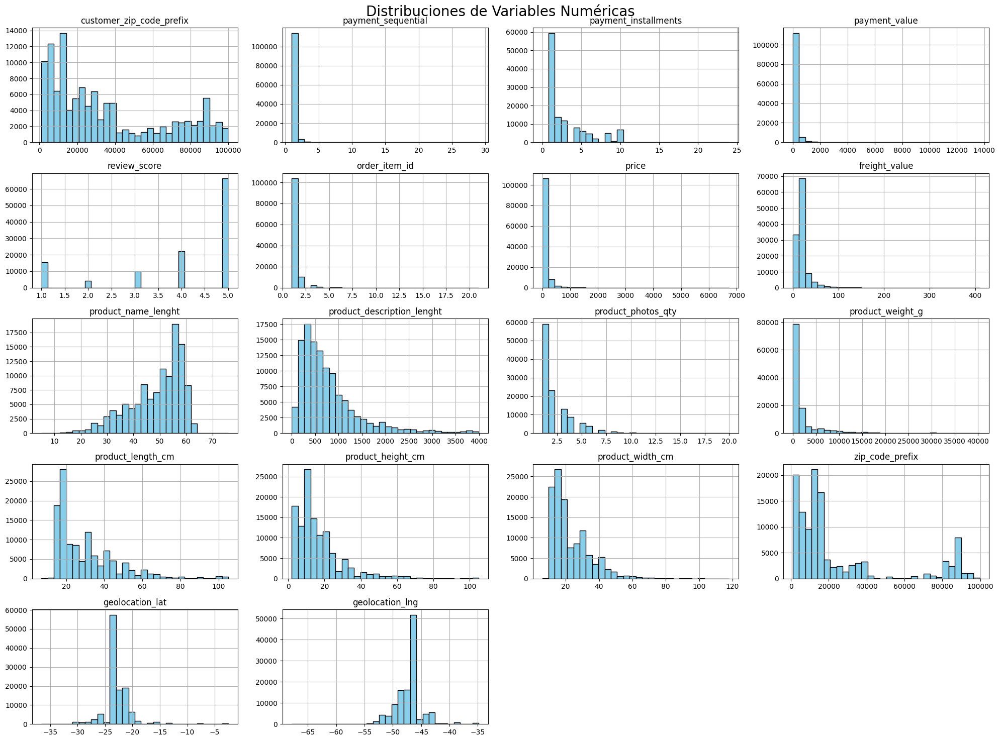

In [7]:
def plot_numeric_distributions(numeric_df):
    numeric_df.hist(bins=30, figsize=(20, 15), color='skyblue', edgecolor='black')
    plt.suptitle("Distribuciones de Variables Numéricas", fontsize=20)
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    plt.show()

plot_numeric_distributions(numerical_df)

**1. customer_zip_code_prefix**
Esta variable representa el prefijo del código postal del cliente. La distribución muestra múltiples picos, lo que sugiere una concentración de clientes en zonas geográficas específicas de Brasil, probablemente en áreas urbanas densamente pobladas como São Paulo o Río de Janeiro. Esta variable puede ser útil para análisis regionales o segmentación geográfica de la clientela.

**2. payment_sequential**
Representa la secuencia del pago realizado por el cliente dentro de un pedido. La mayoría de los valores están en 1, lo que indica que casi todos los pedidos fueron pagados en una sola transacción. La baja variabilidad sugiere que esta variable no tiene gran valor predictivo, aunque podría señalar patrones de comportamiento poco frecuentes cuando supera la media.

**3. payment_installments**
Esta variable indica el número de cuotas en las que se realizó el pago. La distribución está sesgada a la izquierda, mostrando que la mayoría de los pagos fueron hechos en pocas cuotas, principalmente entre 1 y 3. Esto refleja una preferencia común en Brasil por financiar compras pequeñas, lo que puede ser relevante en análisis de comportamiento de pago.

**4. payment_value**
Corresponde al valor total pagado por el cliente. Se observa una distribución altamente sesgada a la derecha, con muchos pagos pequeños y unos pocos valores extremadamente altos. Esto sugiere una concentración en productos económicos, aunque los valores atípicos podrían ser compras de productos premium o pedidos múltiples. Puede necesitar normalización para modelos predictivos.

**5. review_score**
Es el puntaje de la reseña que va de 1 a 5. La distribución es bimodal, con la mayoría de las puntuaciones en los extremos: 1 estrella o 5 estrellas. Esto refleja una tendencia de los clientes a calificar solo cuando están muy satisfechos o insatisfechos. Esta variable es clave para modelar la experiencia del cliente y puede binarizarse para ciertos análisis.

**6. order_item_id**
Representa la posición del ítem dentro de una orden. La mayoría de los pedidos tienen solo un producto, como lo indica el fuerte sesgo hacia 1. Esto revela un comportamiento de compra individualizada y puede relacionarse con la simplicidad logística o con categorías de productos de compra frecuente.

**7. price**
Es el precio del producto sin incluir el costo de envío. La distribución es sesgada a la derecha, lo que indica que la mayoría de los productos son de bajo precio, pero existen algunos artículos considerablemente más caros. Esto puede influir significativamente en los ingresos y decisiones de marketing, y debe considerarse cuidadosamente al modelar.

**8. freight_value**
Corresponde al costo del envío pagado por el cliente. Al igual que otras variables monetarias, presenta un fuerte sesgo positivo. La mayoría de los valores son bajos, pero existen algunos costos de envío desproporcionados que podrían ser producto de distancias grandes o productos voluminosos. Esta variable puede impactar negativamente en la satisfacción del cliente.

**9. product_name_lenght**
Mide la longitud del nombre del producto. La distribución parece normal, con la mayoría de los nombres entre 40 y 60 caracteres. Esto indica consistencia en la longitud de los nombres y puede estar relacionado con la estandarización de catálogos. Sin embargo, nombres excesivamente cortos o largos podrían afectar la percepción del producto.

**10. product_description_lenght**
Indica la longitud de la descripción del producto. Tiene una distribución sesgada positivamente, con la mayoría de las descripciones siendo detalladas, entre 500 y 1500 caracteres. Esto sugiere que los vendedores se esfuerzan por proporcionar información completa. Una descripción más larga puede correlacionarse con mayor conversión o satisfacción del cliente.

**11. product_photos_qty**
Cantidad de fotos asociadas a un producto. La mayoría de los productos tienen una sola foto, con pocos casos que superan las 5. Esto puede indicar limitaciones en la calidad del catálogo o falta de inversión del vendedor. Productos con más imágenes pueden generar más confianza y mejorar la tasa de conversión.

**12. product_weight_g**
Mide el peso del producto en gramos. La distribución es muy sesgada a la derecha, con muchos productos livianos y unos pocos muy pesados. Esta variable es fundamental para la logística y puede afectar el costo de envío. Los outliers podrían requerir tratamiento para evitar sesgos en modelos predictivos.

**13. product_length_cm**
Longitud del producto en centímetros. Similar al peso, la mayoría de los productos son pequeños, con algunos valores extremos que podrían corresponder a productos mal registrados o atípicos. Es relevante para empaques y envíos, y debería revisarse la calidad de datos.

**14. product_height_cm**
Altura del producto en centímetros. Su distribución sigue el mismo patrón que las otras dimensiones físicas, con la mayoría de los valores bajos y una cola larga hacia la derecha. Los productos con valores atípicos pueden requerir revisión o transformación logarítmica.

**15. product_width_cm**
Ancho del producto. También sesgada a la derecha, muestra que la mayoría de los productos tienen un ancho modesto. Al igual que las otras dimensiones, esta variable puede ser utilizada para predecir costos de envío, espacio de almacenamiento o empaques.

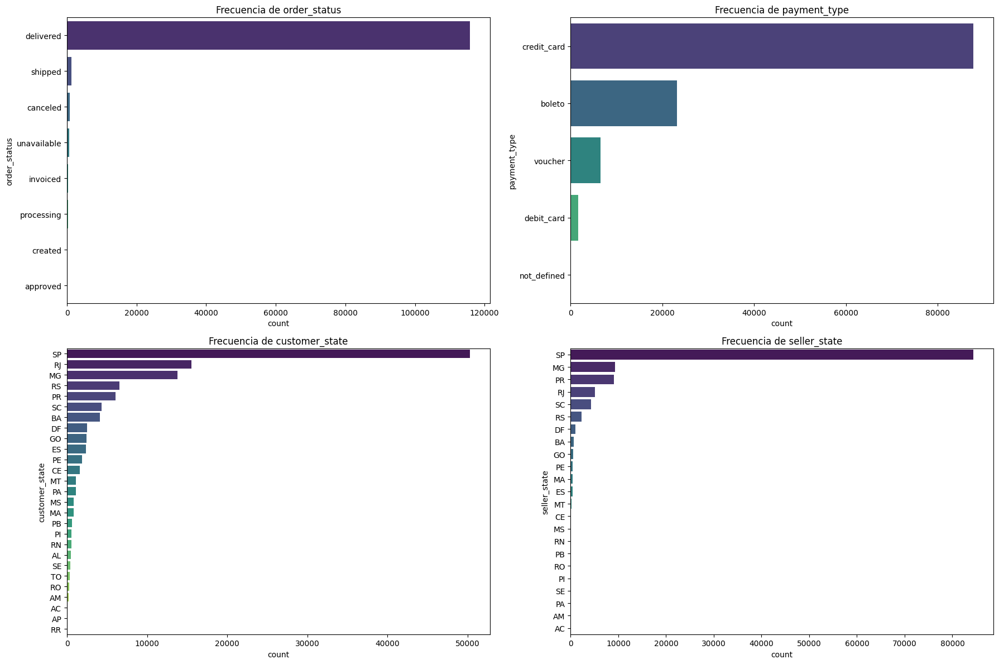

In [8]:
def plot_categorical_frequencies(df):
    cat_cols = ['order_status', 'payment_type', 'customer_state', 'seller_state']
    fig, axes = plt.subplots(2, 2, figsize=(18, 12))
    for ax, col in zip(axes.flatten(), cat_cols):
        sns.countplot(data=df, y=col, order=df[col].value_counts().index, ax=ax, palette='viridis')
        ax.set_title(f'Frecuencia de {col}')
    plt.tight_layout()
    plt.show()

plot_categorical_frequencies(data)

**1. order_status**
Esta gráfica muestra que la gran mayoría de los pedidos tienen el estado delivered, lo que indica un alto nivel de cumplimiento en la entrega de órdenes. Otros estados como shipped, canceled, unavailable o invoiced tienen frecuencias marginales, lo cual puede reflejar transacciones fallidas o en proceso. El hecho de que tan pocos pedidos estén en estados intermedios sugiere una operación eficiente o que los datos recogen principalmente eventos cerrados (entregados o cancelados).

**2. payment_type**
Aquí se observa que el método de pago más común es la credit_card, seguido por boleto (boleto bancario, un método tradicional brasileño), y luego voucher y debit_card. Esta distribución indica una fuerte preferencia por el financiamiento con tarjeta de crédito en las compras en línea. La presencia de métodos alternativos como boleto destaca la necesidad de ofrecer varias opciones de pago en el mercado brasileño.

**3. customer_state**
El estado de origen del cliente más representado es SP (São Paulo), seguido por RJ (Río de Janeiro), MG (Minas Gerais) y RS (Rio Grande do Sul). Esto refleja la concentración demográfica y económica de Brasil en estas regiones. También se nota una caída pronunciada en otros estados, lo que sugiere que la mayoría de las compras provienen de las regiones más desarrolladas del país.

**4. seller_state**
Al igual que los clientes, los vendedores se concentran principalmente en el estado de São Paulo (SP), lo cual es coherente con la ubicación de muchos centros logísticos y comerciales en ese estado. Otros estados como MG, PR, y RJ también tienen presencia, pero en menor medida. Esto puede tener implicaciones logísticas importantes, como costos de envío y tiempos de entrega.

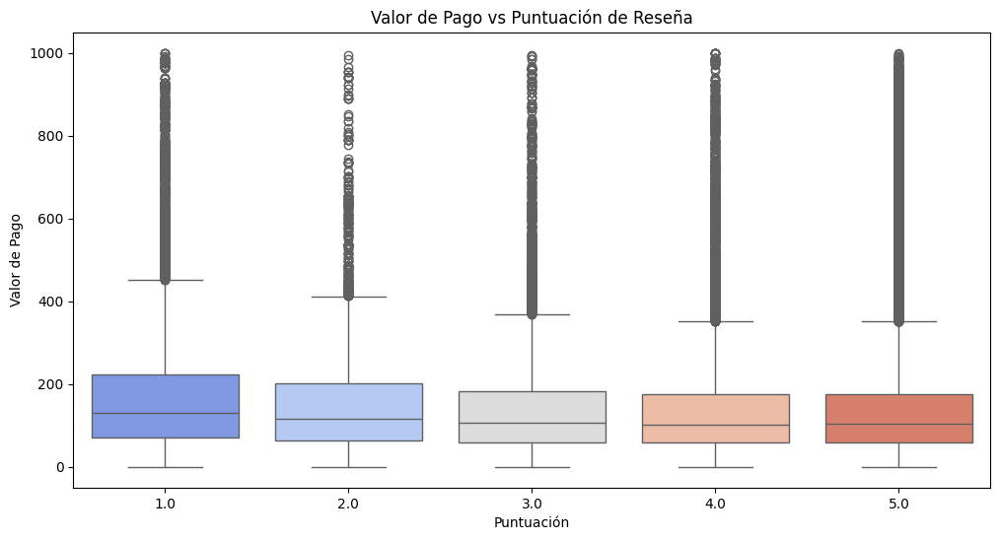

In [9]:
def plot_payment_vs_review(df):
    sns.boxplot(x='review_score', y='payment_value', data=df[df['payment_value'] < 1000], palette='coolwarm')
    plt.title('Valor de Pago vs Puntuación de Reseña')
    plt.xlabel('Puntuación')
    plt.ylabel('Valor de Pago')
    plt.show()

plot_payment_vs_review(data)

Esta gráfica de caja (boxplot) muestra la relación entre el valor del pago (payment_value) y la calificación dada por el cliente (review_score). Se observa que, en promedio, los valores de pago son similares para todas las puntuaciones, aunque con ligeras diferencias: las puntuaciones más bajas (1 y 2) presentan una mayor variabilidad en los montos. Además, los outliers son abundantes en todos los niveles de puntuación, lo que indica que hay compras costosas asociadas a todo tipo de reseñas. No parece haber una relación directa fuerte entre el monto pagado y la satisfacción del cliente, lo cual sugiere que otros factores como logística o atención podrían tener mayor impacto en la evaluación del servicio.

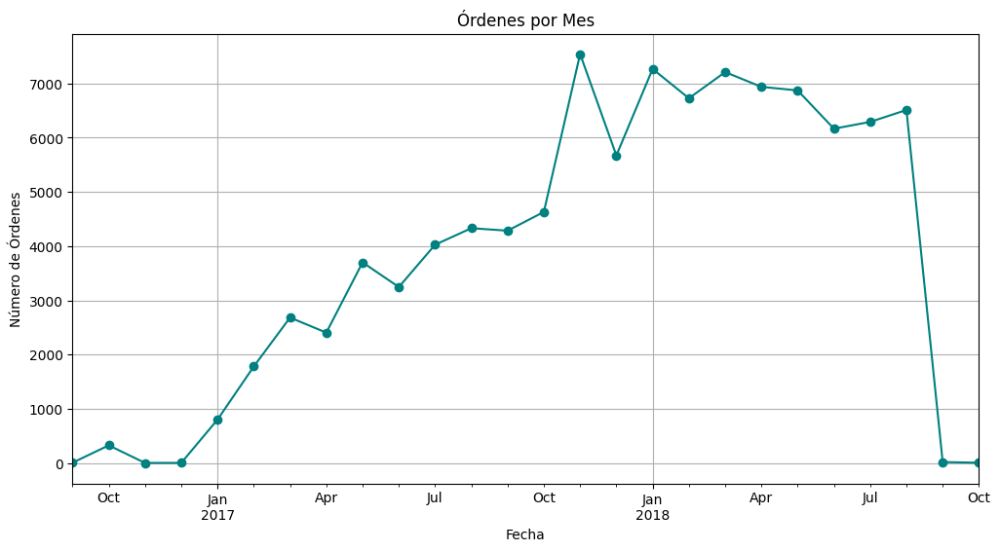

In [10]:
def plot_orders_over_time(df):
    df['order_purchase_timestamp'] = pd.to_datetime(df['order_purchase_timestamp'])
    monthly_orders = df.set_index('order_purchase_timestamp').resample('M')['order_id'].nunique()
    monthly_orders.plot(kind='line', marker='o', color='teal')
    plt.title('Órdenes por Mes')
    plt.xlabel('Fecha')
    plt.ylabel('Número de Órdenes')
    plt.grid(True)
    plt.show()
plot_orders_over_time(data)

Esta serie temporal muestra el número de órdenes mensuales a lo largo del tiempo. A partir de finales de 2016 hasta mediados de 2018, se observa una clara tendencia creciente, con un crecimiento acelerado hasta alcanzar un pico en diciembre de 2017, coincidiendo posiblemente con la temporada navideña. Luego, se mantiene un nivel alto con ligeras oscilaciones hasta mediados de 2018. Finalmente, hay una caída abrupta al final, que probablemente se deba a datos incompletos o un corte en la recolección. Esta información es muy útil para identificar ciclos de demanda, estacionalidad y periodos de mayor actividad comercial.

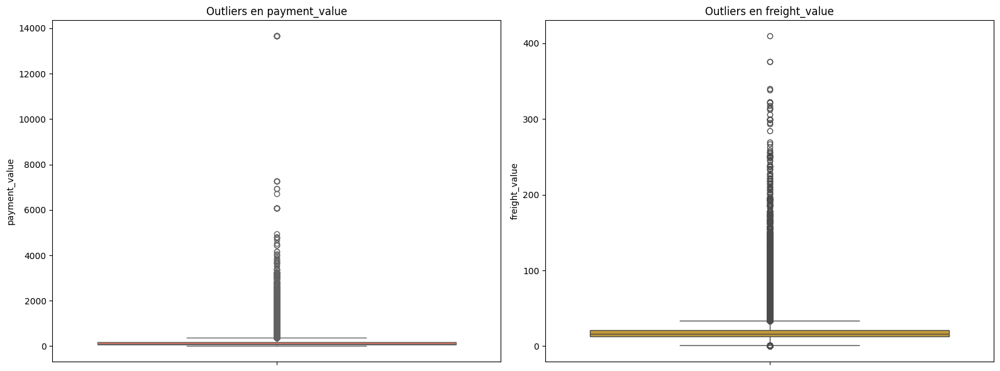

In [11]:
def plot_outliers(df):
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    sns.boxplot(y=df['payment_value'], ax=axes[0], color='tomato')
    axes[0].set_title("Outliers en payment_value")

    sns.boxplot(y=df['freight_value'], ax=axes[1], color='goldenrod')
    axes[1].set_title("Outliers en freight_value")

    plt.tight_layout()
    plt.show()

plot_outliers(data)

Las dos gráficas de caja aquí ilustran la presencia de valores atípicos (outliers) tanto en el valor del pago (payment_value) como en el valor del flete (freight_value). En ambos casos, se nota una fuerte concentración de datos en la parte baja del eje Y, mientras que algunos valores extremos superan por mucho el rango intercuartílico. Esto indica que existen compras o envíos excepcionalmente caros que podrían distorsionar análisis estadísticos si no se tratan adecuadamente. Para modelado o visualizaciones más precisas, podría ser recomendable aplicar transformaciones logarítmicas o recortes (winsorization) a estas variables.

In [12]:
from ydata_profiling import ProfileReport
reporte = ProfileReport(data, title="Datos ecommerce Brazil", explorative=True)
reporte.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 44/44 [00:17<00:00,  2.51it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

ProfileReport es una herramienta que genera automáticamente un análisis exploratorio completo de tu dataset. Es como tener un analista de datos que examina todos los aspectos de tus datos y te entrega un reporte profesional.

**ALERTAS MENCIONADAS**

Las alertas presentadas se agrupan en tres categorías clave: alta correlación entre variables, desbalance en la distribución de clases y presencia de valores faltantes. En cuanto a la alta correlación, se identifican varias parejas de variables fuertemente relacionadas, como customer_state con customer_zip_code_prefix, y geolocation_lat/lng con geolocation_state. También hay redundancia entre características del producto, como product_height_cm, product_weight_g y product_length_cm, lo que indica que podrían condensarse en métricas derivadas como volumen o peso total. Este tipo de correlaciones puede provocar multicolinealidad, lo que afecta negativamente a modelos lineales o de regresión, por lo tanto, se sugiere eliminar o transformar algunas variables para reducir la redundancia.

Respecto a los desbalances en las variables categóricas, se observa que order_status está altamente desbalanceada, con un 91.6% de los datos pertenecientes a una sola clase, lo cual puede influir en el rendimiento de modelos predictivos que intenten clasificar esta variable. También hay desbalance en payment_type, seller_state y geolocation_state, lo que puede requerir técnicas como sobremuestreo o submuestreo para evitar sesgos. Por último, las alertas de valores faltantes indican que algunas variables tienen tasas significativas de nulls, especialmente review_comment_title (88.3%) y review_comment_message (57.8%), lo que sugiere que los comentarios no son obligatorios. Dado su carácter textual y opcional, podría considerarse eliminarlas o tratarlas como ausencia de texto. Para las otras variables con cerca del 2% de faltantes, como características de productos y fechas de entrega, se recomienda imputar con valores promedio, moda o utilizando modelos específicos si se requiere mayor precisión.

**VARIABLES RELEVANTES**

**La variable order_status** presenta una distribución altamente desbalanceada, donde el 97.1% de los pedidos tienen el estado "delivered". Esto indica que la mayoría de las órdenes llegaron exitosamente a los clientes, mientras que los estados como “shipped”, “canceled”, “unavailable”, entre otros, representan una proporción muy pequeña (cada uno con menos del 1.1%). Este desbalance puede afectar modelos de clasificación o análisis de calidad del servicio, ya que habrá muy pocos ejemplos de estados negativos para entrenar el modelo. En estos casos, puede ser necesario aplicar técnicas de re-muestreo o considerar la agrupación de clases minoritarias.

Por su parte, **la variable order_purchase_timestamp** es una variable temporal que no presenta valores faltantes ni inválidos. Tiene una buena cobertura temporal desde septiembre de 2016 hasta octubre de 2018, y muestra un incremento progresivo en la cantidad de compras realizadas, lo que podría reflejar un crecimiento del negocio. Esta variable es útil para análisis temporales como tendencias de ventas, estacionalidad o predicciones de demanda, y puede ser descompuesta en componentes como día, mes, año o incluso hora para enriquecer los modelos.

Finalmente, **la variable customer_state** representa los estados de residencia de los clientes y no tiene valores nulos. Aunque hay 27 estados diferentes, se observa un fuerte desbalance: el estado SP (São Paulo) concentra más del 50% de los registros, seguido por RJ, MG, RS y PR. Esto sugiere una alta concentración de clientes en ciertas regiones, lo cual puede ser relevante para estrategias de marketing, distribución o análisis geoespacial. Dado que esta variable está altamente correlacionada con otras como customer_zip_code_prefix, podría ser redundante dependiendo del nivel de granularidad requerido.